In [1]:
import torch
from torch.utils.data import DataLoader
from dataset import CUBSiamese
from utils import imshow
import torchvision
from torchvision import transforms
from model import SiameseNetwork
from custom_loss import ContrastiveLoss
from trainer import SiameseTrainer, SiameseTester

In [2]:
import os
path = os.path.join(os.getcwd(), 'CUB_200_2011')
print(path)

C:\Users\ani_1\PycharmProjects\Thesis\CUB_200_2011


In [3]:
IMAGE_SIZE = 224
TRAIN_MEAN = [0.48, 0.49, 0.43]
TRAIN_STD = [0.23, 0.22, 0.26]
TEST_MEAN = [0.48, 0.49, 0.43]
TEST_STD = [0.23, 0.22, 0.26]

In [4]:
train_transforms = transforms.Compose([
    transforms.RandomResizedCrop(IMAGE_SIZE),
    transforms.RandomHorizontalFlip(),
    transforms.Resize(IMAGE_SIZE),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [5]:
train_dataset = CUBSiamese(path=path, 
                            is_train=True, 
                            test_classes=['190', '191', '192', '193', '194', '195'],
                            transform=train_transforms)

In [6]:
len(train_dataset)

11430

In [7]:
# Create a simple data loader for visualisation
vis_dataloader = DataLoader(train_dataset,
                           shuffle=True,
                           batch_size=8)

In [8]:
# extracted one batch
example_batch = next(iter(vis_dataloader))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


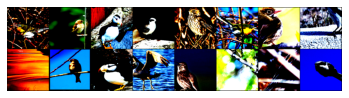

[1. 0. 0. 1. 0. 0. 1. 0.]


In [9]:
# Example batch is a list containing 2x8 images, indexes 0 and 1, an also the label
# If the label is 1, it means that it is not the same class, label is 0, same class in both images
concatenated = torch.cat((example_batch[0], example_batch[1]), 0)


imshow(torchvision.utils.make_grid(concatenated))
print(example_batch[2].numpy().reshape(-1))

In [10]:
# Load training data
train_dataloader = DataLoader(dataset=train_dataset, shuffle=True, batch_size=64)

In [11]:
# Instantiate the model
model = SiameseNetwork()

In [12]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

# move model to device
model.to(device)

cuda:0


SiameseNetwork(
  (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2))
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2))
  (conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2))
  (conv4): Conv2d(128, 128, kernel_size=(3, 3), stride=(2, 2))
  (conv5): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2))
  (fc1): Linear(in_features=9216, out_features=4096, bias=True)
  (fc2): Linear(in_features=4096, out_features=10, bias=True)
)

In [13]:
# Loss and optimizer
criterion = ContrastiveLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=3e-4, weight_decay=4e-4)

In [14]:
trainer = SiameseTrainer(model=model, 
                         data_loader=train_dataloader, 
                         criterion=criterion, 
                         optimizer=optimizer,
                         device=device,
                         epochs=10)

=== Epoch: 0 ===
Avg Train Acc: 1.0
Epoch number 0
 Current loss 1.4078707695007324

Avg Train Acc: 0.515625
Avg Train Acc: 0.4583333333333333
Avg Train Acc: 0.39453125
Avg Train Acc: 0.390625
Avg Train Acc: 0.4166666666666667
Avg Train Acc: 0.46651785714285715
Avg Train Acc: 0.505859375
Avg Train Acc: 0.5295138888888888
Avg Train Acc: 0.540625
Avg Train Acc: 0.5355113636363636
Epoch number 0
 Current loss 1.3111876249313354

Avg Train Acc: 0.5403645833333334
Avg Train Acc: 0.5552884615384616
Avg Train Acc: 0.5814732142857143
Avg Train Acc: 0.6020833333333333
Avg Train Acc: 0.611328125
Avg Train Acc: 0.6213235294117647
Avg Train Acc: 0.6189236111111112
Avg Train Acc: 0.6118421052631579
Avg Train Acc: 0.6078125
Avg Train Acc: 0.6101190476190477
Epoch number 0
 Current loss 1.0918095111846924

Avg Train Acc: 0.6136363636363636
Avg Train Acc: 0.6154891304347826
Avg Train Acc: 0.62109375
Avg Train Acc: 0.621875
Avg Train Acc: 0.6231971153846154
Avg Train Acc: 0.625
Avg Train Acc: 0.625
Avg

Avg Train Acc: 0.6377561848168809
Avg Train Acc: 0.6375543215837759
Avg Train Acc: 0.6382818132660418
Avg Train Acc: 0.6385055322966506
Epoch number 1
 Current loss 0.9573074579238892

Avg Train Acc: 0.6391514348654441
Avg Train Acc: 0.6397211356092934
Avg Train Acc: 0.6405659959877271
Avg Train Acc: 0.6410545406484962
Avg Train Acc: 0.6418859649122807
Avg Train Acc: 0.6425717571029343
Avg Train Acc: 0.6422878506839786
Avg Train Acc: 0.6424861495844875
Avg Train Acc: 0.6418639393242932
Avg Train Acc: 0.6414509439359267
Epoch number 1
 Current loss 0.8997496366500854

Avg Train Acc: 0.6411768056504898
Avg Train Acc: 0.6407703323502723
Avg Train Acc: 0.6402332279195844
Avg Train Acc: 0.6397007141250562
Avg Train Acc: 0.6392392217245241
Avg Train Acc: 0.6387154326494201
Avg Train Acc: 0.6385257050854986
Avg Train Acc: 0.6386001769128704
Avg Train Acc: 0.6391970380973354
Avg Train Acc: 0.6387472587719298
Epoch number 1
 Current loss 1.0228983163833618

Avg Train Acc: 0.6386253821795151
Avg

Avg Train Acc: 0.6420405522001724
Avg Train Acc: 0.6417816957697983
Avg Train Acc: 0.6419246871549502
Epoch number 2
 Current loss 1.0688506364822388

Avg Train Acc: 0.6423940483476132
Avg Train Acc: 0.6425349554280131
Avg Train Acc: 0.6426390411793371
Avg Train Acc: 0.6430674152181839
Avg Train Acc: 0.6432417990540867
Avg Train Acc: 0.6431280248033877
Avg Train Acc: 0.643122283920811
Avg Train Acc: 0.6427590178248824
Avg Train Acc: 0.6422903899303051
Avg Train Acc: 0.6419662660352474
Epoch number 2
 Current loss 0.9681400060653687

Avg Train Acc: 0.6416081040669855
Avg Train Acc: 0.6414641514500536
Avg Train Acc: 0.6414269022386282
Avg Train Acc: 0.6416367173577283
Avg Train Acc: 0.642056736012328
Avg Train Acc: 0.6424046422235363
Avg Train Acc: 0.6428911228463534
Avg Train Acc: 0.6432705610502766
Avg Train Acc: 0.6434739191729323
Avg Train Acc: 0.6435371732504981
Epoch number 2
 Current loss 1.0994243621826172

Avg Train Acc: 0.6435654239766081
Avg Train Acc: 0.643766775586416
Avg Tr

Avg Train Acc: 0.6376918429315046
Avg Train Acc: 0.6379413463124897
Epoch number 3
 Current loss 0.9981662631034851

Avg Train Acc: 0.6381900687752244
Avg Train Acc: 0.6382182874177632
Avg Train Acc: 0.6383195459397324
Avg Train Acc: 0.6383474749959009
Avg Train Acc: 0.6384482176475403
Avg Train Acc: 0.6384030728996404
Avg Train Acc: 0.638140044879641
Avg Train Acc: 0.6378294565748738
Avg Train Acc: 0.6374956784348816
Avg Train Acc: 0.637259381091618
Epoch number 3
 Current loss 1.0973730087280273

Avg Train Acc: 0.6371201139404753
Avg Train Acc: 0.6369331983805668
Avg Train Acc: 0.6370108739590913
Avg Train Acc: 0.6371841701646755
Avg Train Acc: 0.6372612235028613
Avg Train Acc: 0.6374097155158539
Avg Train Acc: 0.6373907693852954
Avg Train Acc: 0.637300425224647
Avg Train Acc: 0.6374006148361773
Avg Train Acc: 0.6370730683090706
Epoch number 3
 Current loss 0.8685623407363892

Avg Train Acc: 0.6367465158533664
Avg Train Acc: 0.63620788476874
Avg Train Acc: 0.636001821402978
Avg Train

Avg Train Acc: 0.6381015814329211
Epoch number 4
 Current loss 0.9834034442901611

Avg Train Acc: 0.6381229828699105
Avg Train Acc: 0.6381075258818424
Avg Train Acc: 0.6381288699690402
Avg Train Acc: 0.638241967654153
Avg Train Acc: 0.6384648350630096
Avg Train Acc: 0.6386322268155734
Avg Train Acc: 0.6386711527794896
Avg Train Acc: 0.6388379116651277
Avg Train Acc: 0.6389130134038367
Avg Train Acc: 0.6389697076705766
Epoch number 4
 Current loss 1.0224885940551758

Avg Train Acc: 0.6387348944914734
Avg Train Acc: 0.6384824382697138
Avg Train Acc: 0.6382850749694002
Avg Train Acc: 0.6382696451494589
Avg Train Acc: 0.638308630479912
Avg Train Acc: 0.6384561581386838
Avg Train Acc: 0.6384586683723197
Avg Train Acc: 0.638497299969577
Avg Train Acc: 0.6385177996231919
Avg Train Acc: 0.6384120985855642
Epoch number 4
 Current loss 1.0304981470108032

Avg Train Acc: 0.6382526376424933
Avg Train Acc: 0.6380755632608563
Avg Train Acc: 0.6377911373260737
Avg Train Acc: 0.6375791210949302
Avg Tr

Avg Train Acc: 0.6328735746651396
Avg Train Acc: 0.6330581223261367
Avg Train Acc: 0.6331833035137419
Avg Train Acc: 0.6333229890764647
Avg Train Acc: 0.6333004179274765
Avg Train Acc: 0.6331160484190702
Avg Train Acc: 0.6329320257959102
Avg Train Acc: 0.6325427569746735
Avg Train Acc: 0.6321982332592043
Avg Train Acc: 0.6319716167176853
Epoch number 5
 Current loss 1.1432065963745117

Avg Train Acc: 0.6318040003946135
Avg Train Acc: 0.6317391090084762
Avg Train Acc: 0.631776654276008
Avg Train Acc: 0.6317411153467781
Avg Train Acc: 0.6317931777974347
Avg Train Acc: 0.6318742942360566
Avg Train Acc: 0.6320135073821552
Avg Train Acc: 0.6321356157502694
Avg Train Acc: 0.6321356157502694
=== Epoch: 6 ===
Avg Train Acc: 0.6320708384332925
Epoch number 6
 Current loss 0.949948251247406

Avg Train Acc: 0.6319480960183916
Avg Train Acc: 0.631724026291355
Avg Train Acc: 0.631616327751196
Avg Train Acc: 0.631479866835764
Avg Train Acc: 0.6314304641812865
Avg Train Acc: 0.6312077024197866
Avg Tr

Avg Train Acc: 0.6290014134863225
Avg Train Acc: 0.6289859230257966
Avg Train Acc: 0.6288841991117384
Avg Train Acc: 0.628844199742856
Avg Train Acc: 0.6286812318690428
Avg Train Acc: 0.6285308139053377
Avg Train Acc: 0.6284543352780537
Avg Train Acc: 0.6285129925166413
Avg Train Acc: 0.6284734415021069
Epoch number 7
 Current loss 1.1504318714141846

Avg Train Acc: 0.6285687564499485
Avg Train Acc: 0.6286884125969312
Avg Train Acc: 0.6288690598854223
Avg Train Acc: 0.6290249722016309
Avg Train Acc: 0.6291562075634748
Avg Train Acc: 0.6292506167763159
Avg Train Acc: 0.629235101072353
Avg Train Acc: 0.6291708576237787
Avg Train Acc: 0.6290214649054438
Avg Train Acc: 0.6288236288735859
Epoch number 7
 Current loss 0.9347115755081177

Avg Train Acc: 0.628626100757731
Avg Train Acc: 0.6283924296062864
Avg Train Acc: 0.6283290905001432
Avg Train Acc: 0.6282294561131089
Avg Train Acc: 0.6280814891184517
Avg Train Acc: 0.6280185383516932
Avg Train Acc: 0.627979891149252
Avg Train Acc: 0.62795

Avg Train Acc: 0.6234688468802337
Avg Train Acc: 0.623501597998718
Avg Train Acc: 0.6236505151062239
Avg Train Acc: 0.6237464438122332
Avg Train Acc: 0.6238949944916308
Avg Train Acc: 0.6239379128489239
Avg Train Acc: 0.6240229176278524
Epoch number 8
 Current loss 1.0694475173950195

Avg Train Acc: 0.6240972788693431
Avg Train Acc: 0.6240978867623604
Avg Train Acc: 0.6241405530565984
Avg Train Acc: 0.624151638764025
Avg Train Acc: 0.6241627095713073
Avg Train Acc: 0.6240898165494326
Avg Train Acc: 0.6240275079477217
Avg Train Acc: 0.6239233647499028
Avg Train Acc: 0.6238403061944405
Avg Train Acc: 0.623684100363098
Epoch number 8
 Current loss 0.8766080141067505

Avg Train Acc: 0.6235699376453181
Avg Train Acc: 0.6234350246435486
Avg Train Acc: 0.6233316255629046
Avg Train Acc: 0.6233118649579861
Avg Train Acc: 0.6232921307357178
Avg Train Acc: 0.6232515756118113
Avg Train Acc: 0.6232527412280702
Avg Train Acc: 0.6232955441986044
Avg Train Acc: 0.6233799013595906
Avg Train Acc: 0.6234

Avg Train Acc: 0.6214224292577917
Avg Train Acc: 0.6213597530556247
Avg Train Acc: 0.6213249041787416
Avg Train Acc: 0.621299342105263
Avg Train Acc: 0.6213200107379625
Avg Train Acc: 0.6212575432375264
Epoch number 9
 Current loss 0.950255811214447

Avg Train Acc: 0.6212966705008237
Avg Train Acc: 0.6212988566457465
Avg Train Acc: 0.6212918219220617
Avg Train Acc: 0.6212295183714001
Avg Train Acc: 0.6212225327978165
Avg Train Acc: 0.6212247574545905
Avg Train Acc: 0.6211717999752175
Avg Train Acc: 0.6211556695046438
Avg Train Acc: 0.6211303722268634
Avg Train Acc: 0.6211326458036983
Epoch number 9
 Current loss 0.9438906908035278

Avg Train Acc: 0.621171616651729
Avg Train Acc: 0.6211738633555719
Avg Train Acc: 0.6210661367494983
Avg Train Acc: 0.6210043306904423
Avg Train Acc: 0.621015824931397
Avg Train Acc: 0.6209998613336619
Avg Train Acc: 0.620965630870623
Avg Train Acc: 0.620913165589412
Avg Train Acc: 0.6208516295487403
Avg Train Acc: 0.6207719118912935
Epoch number 9
 Current 

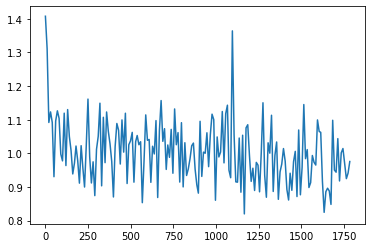

In [15]:
model = trainer.train()

In [16]:
#torch.save(model.state_dict(), os.path.join(os.getcwd(), 'siameseModels', 'vanilla.pth'))

In [17]:
#model.load_state_dict(torch.load(os.path.join(os.getcwd(), 'siameseModels', 'vanilla.pth')))

<All keys matched successfully>

In [27]:
model.to('cpu')
device = 'cpu'

In [28]:
test_transforms = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [29]:
test_dataset = CUBSiamese(path=path, 
                            is_train=False, 
                            test_classes=['190', '191', '192', '193', '194', '195'],
                            transform=test_transforms)

In [30]:
len(test_dataset)

358

In [31]:
test_dataset.__getitem__(0)[0].shape

torch.Size([3, 224, 224])

In [32]:
test_dataset.transform

Compose(
    RandomHorizontalFlip(p=0.5)
    Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=None)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)

In [33]:
test_data_loader = DataLoader(dataset=test_dataset, shuffle=True, batch_size=1)

In [43]:
import torch.nn.functional as F
import numpy as np

In [44]:
class SiameseTester_runtime:

    def __init__(self, model, data_loader, device):
        self.model = model
        self.data_loader = data_loader
        self.device = device

    def vis_test(self):
        self.model.eval()
        batch_acc = []

        # grab one image that we are going to test
        with torch.no_grad():
            for i, (x0, x1, label) in enumerate(self.data_loader, 0):
                acc = []
                # Iterate over 64 images and test them with the first image (x0)

                # Concatenate the two images together
                concatenated = torch.cat((x0, x1), 0)

                # send the two images to GPU
                x0, x1 = x0.to(self.device), x1.to(self.device)

                output1, output2 = self.model(x0, x1)

                euclidean_distance = F.pairwise_distance(output1, output2)
                loss_contrastive = (1 - label) * torch.pow(euclidean_distance, 2) + \
                                   label * torch.pow(torch.clamp(2.0 - euclidean_distance, min=0.0), 2)
                for loss_idx in range(len(loss_contrastive)):
                    if loss_contrastive[loss_idx] < 1.0 and label[loss_idx] == 0:
                        acc.append(1)
                    elif loss_contrastive[loss_idx] > 1.0 and label[loss_idx] == 1:
                        acc.append(1)
                    else:
                        acc.append(0)
                batch_acc.append(np.mean(acc))
                imshow(torchvision.utils.make_grid(concatenated), f'Dissimilarity: {euclidean_distance.item():.2f}')
            print('Avg Test Acc: {}'.format(np.mean(batch_acc)))

In [45]:
tester = SiameseTester_runtime(model=model, data_loader=test_data_loader, device=device)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


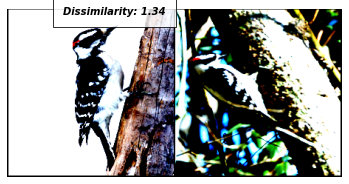

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


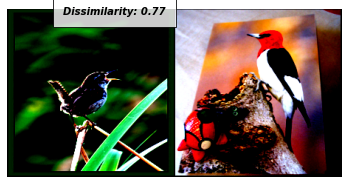

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


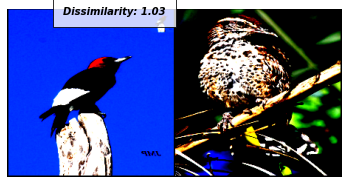

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


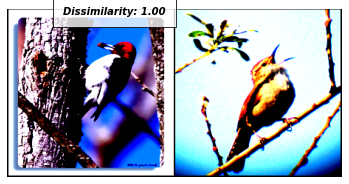

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


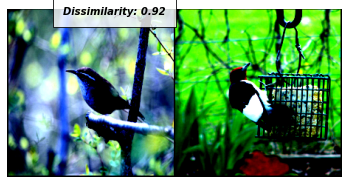

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


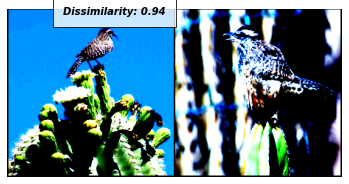

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


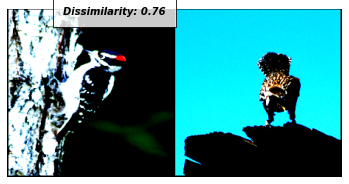

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


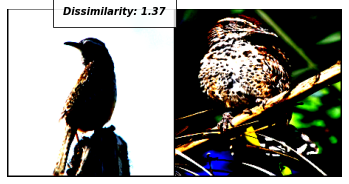

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


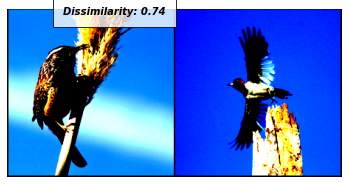

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


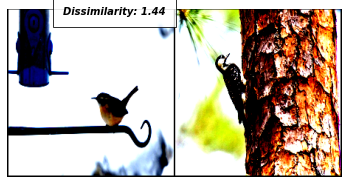

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


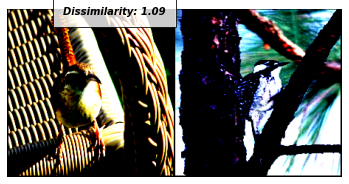

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


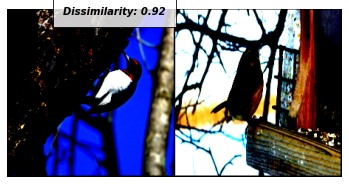

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


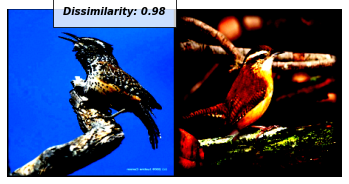

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


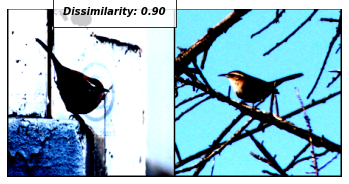

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


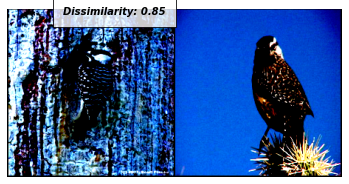

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


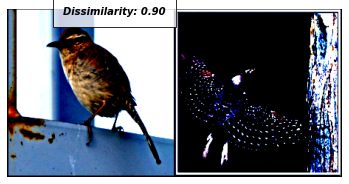

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


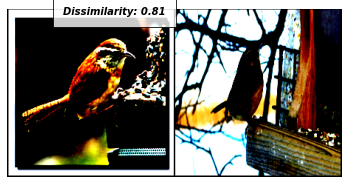

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


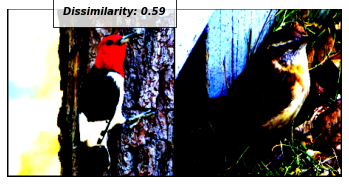

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


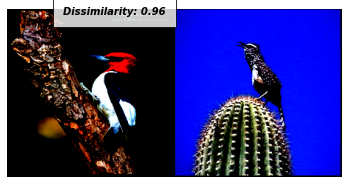

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


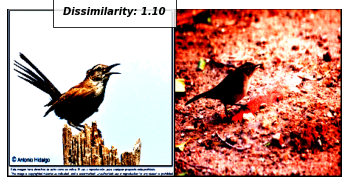

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


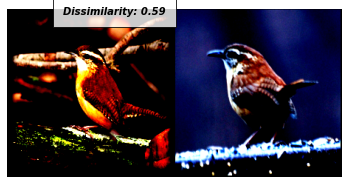

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


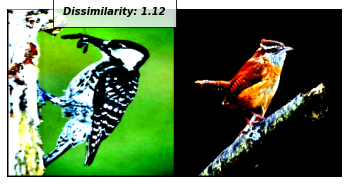

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


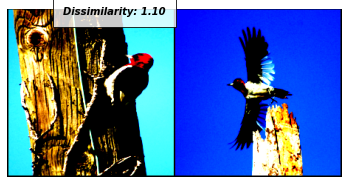

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


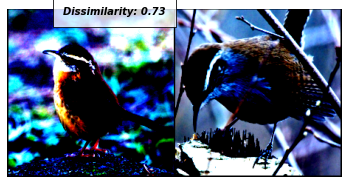

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


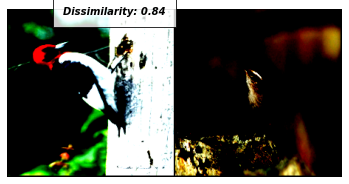

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


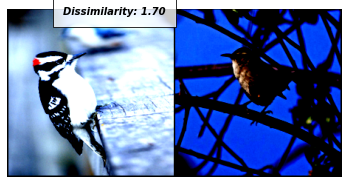

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


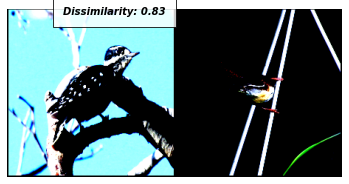

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


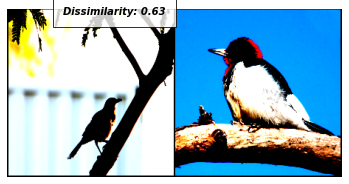

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


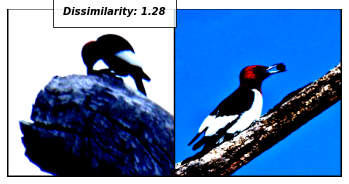

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


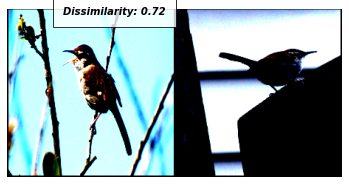

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


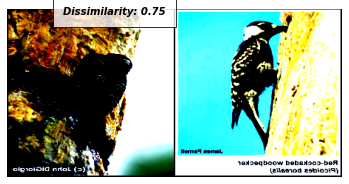

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


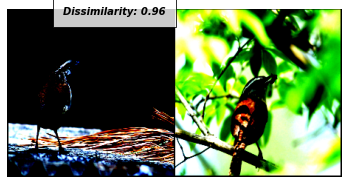

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


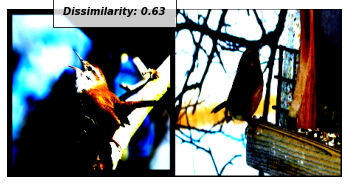

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


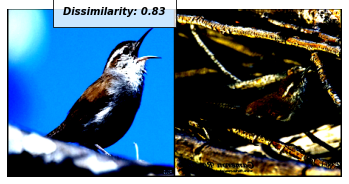

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


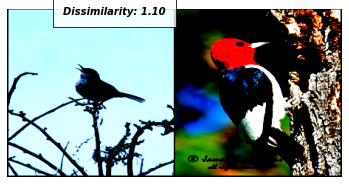

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


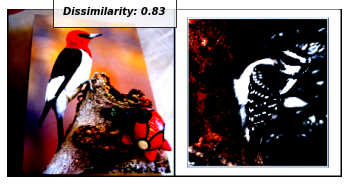

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


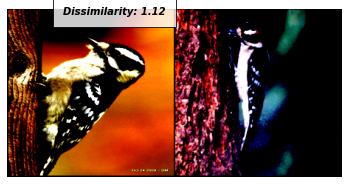

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


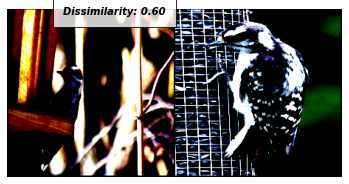

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


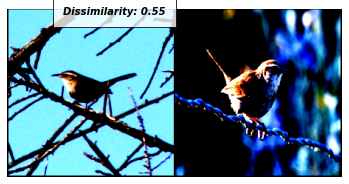

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


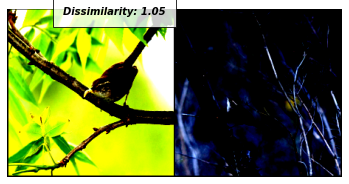

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


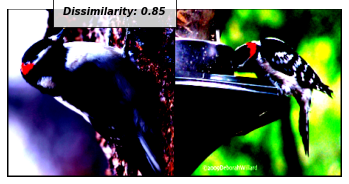

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


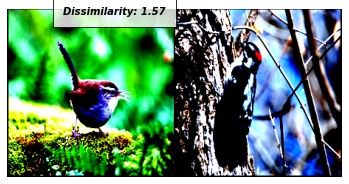

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


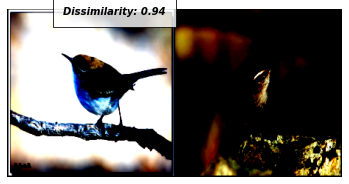

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


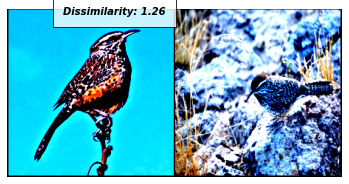

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


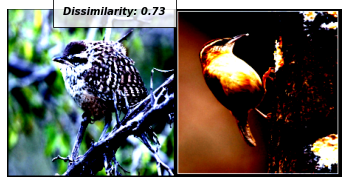

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


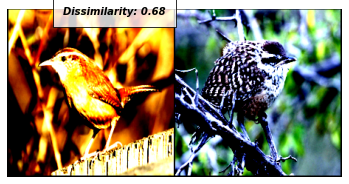

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


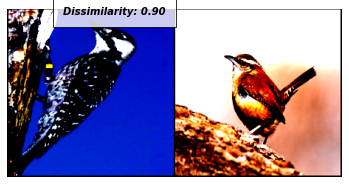

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


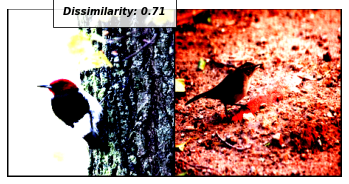

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


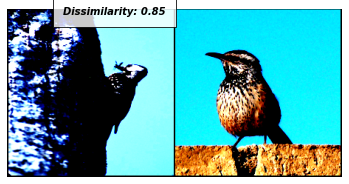

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


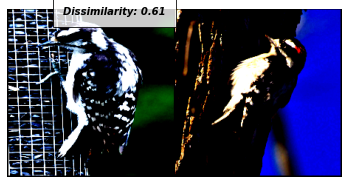

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


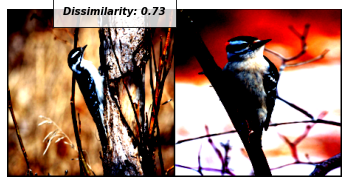

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


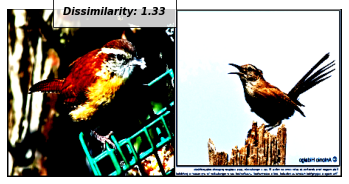

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


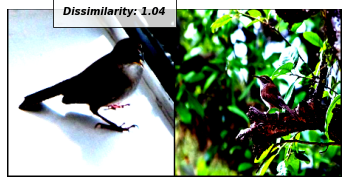

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


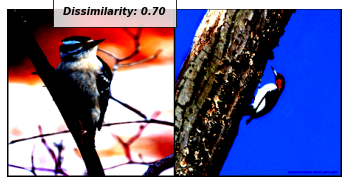

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


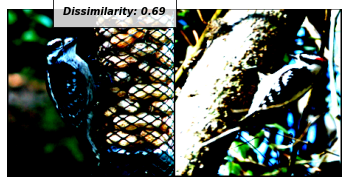

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


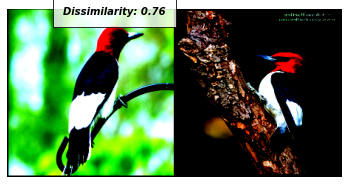

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


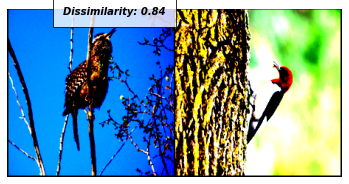

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


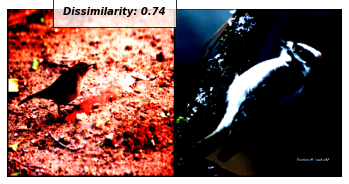

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


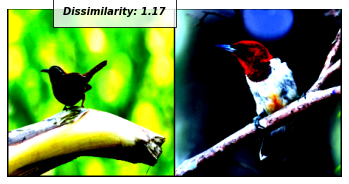

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


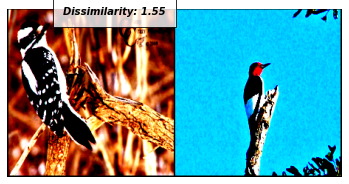

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


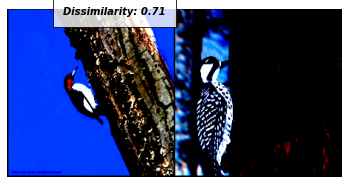

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


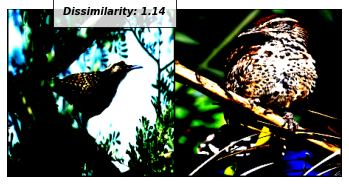

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


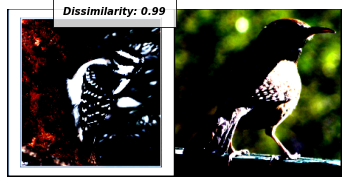

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


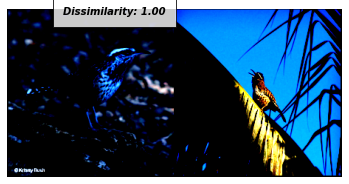

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


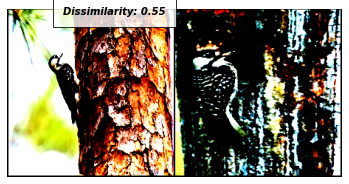

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


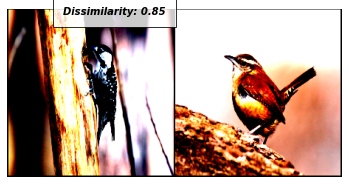

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


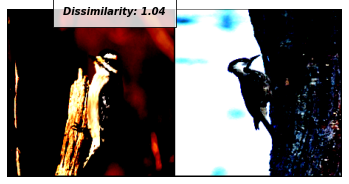

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


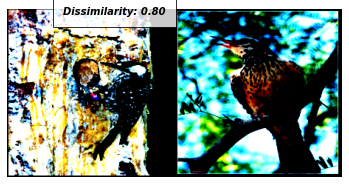

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


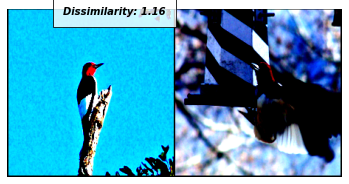

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


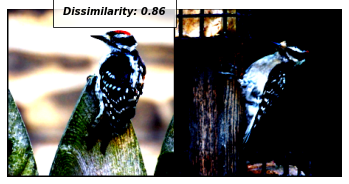

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


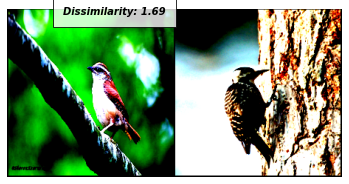

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


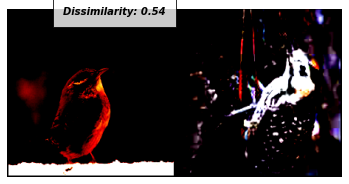

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


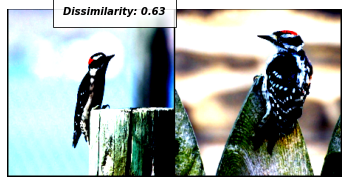

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


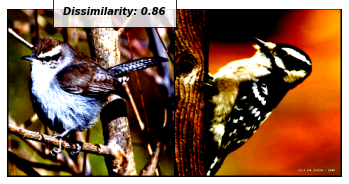

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


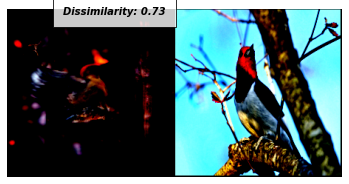

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


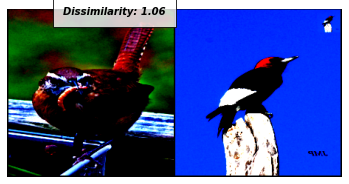

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


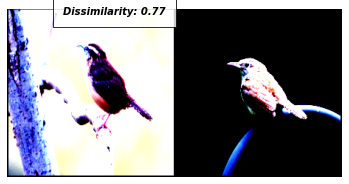

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


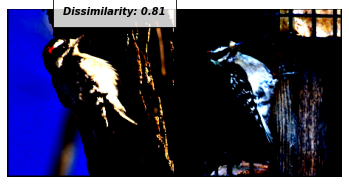

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


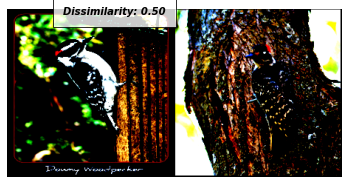

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


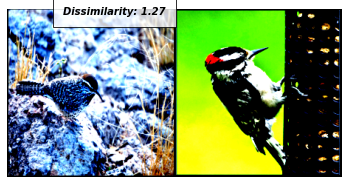

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


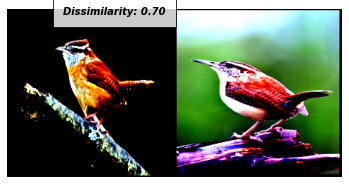

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


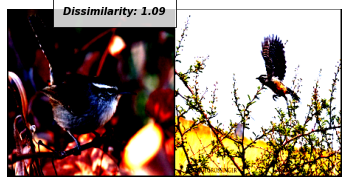

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


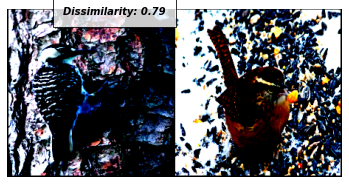

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


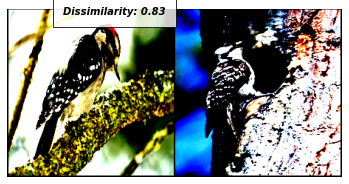

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


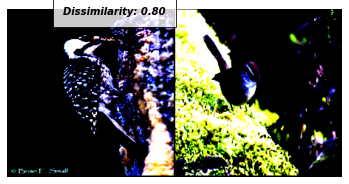

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


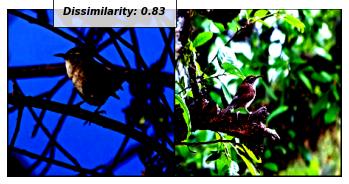

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


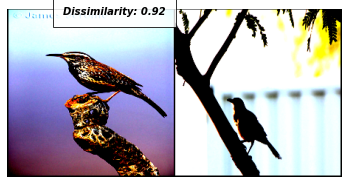

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


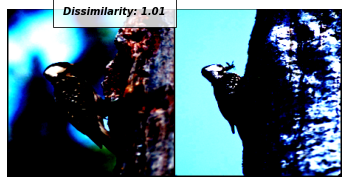

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


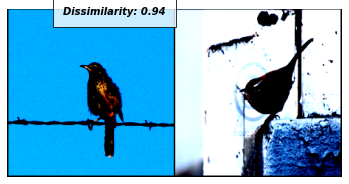

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


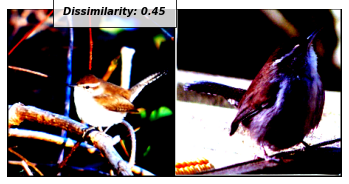

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


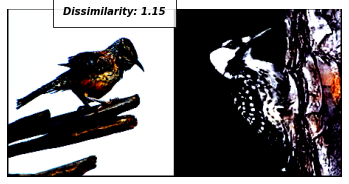

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


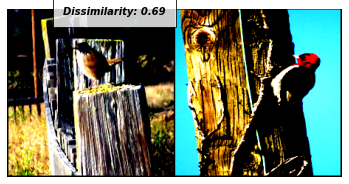

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


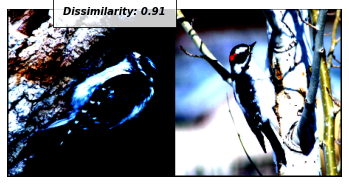

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


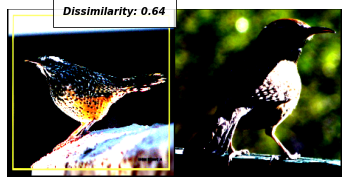

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


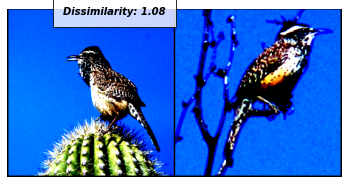

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


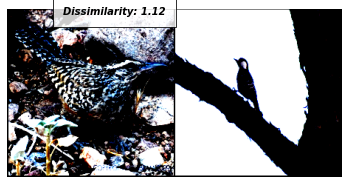

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


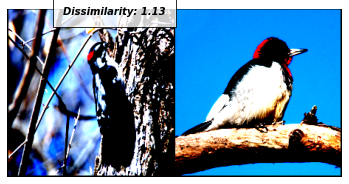

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


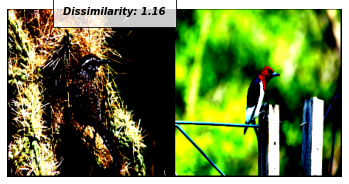

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


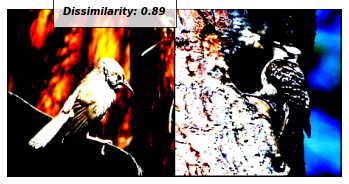

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


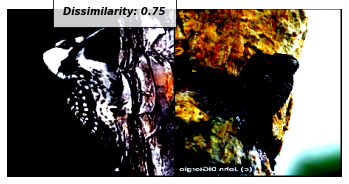

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


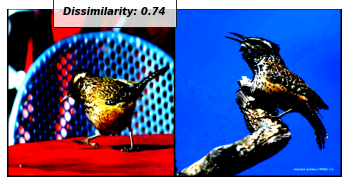

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


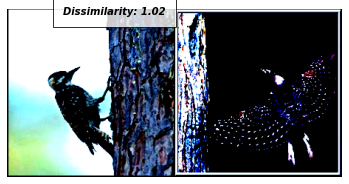

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


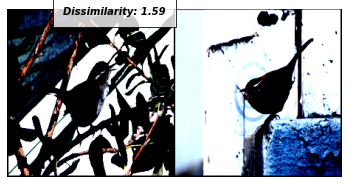

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


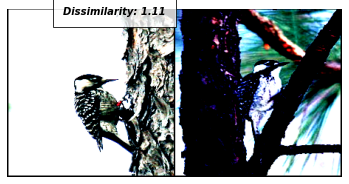

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


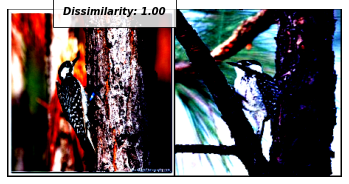

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


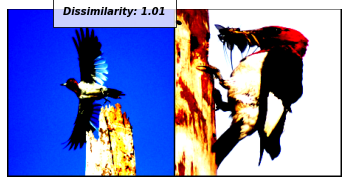

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


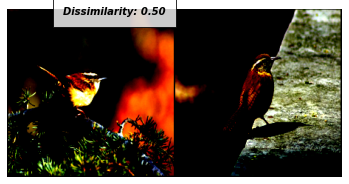

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


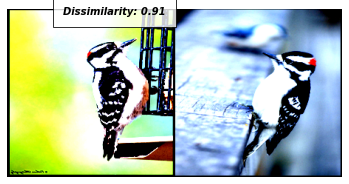

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


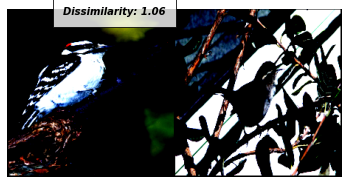

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


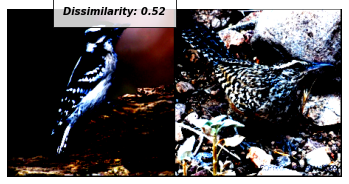

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


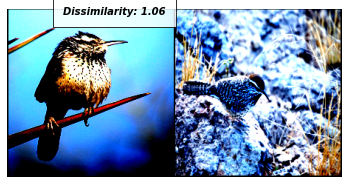

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


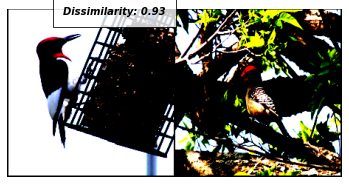

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


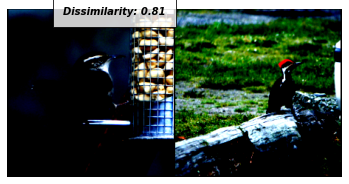

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


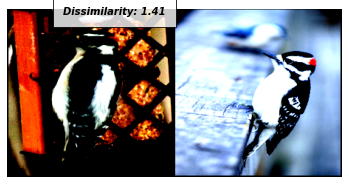

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


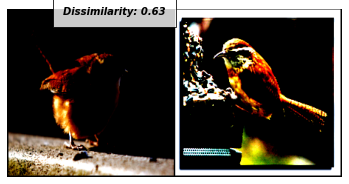

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


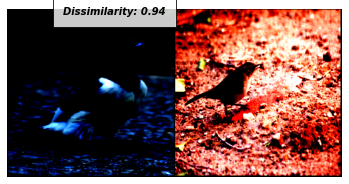

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


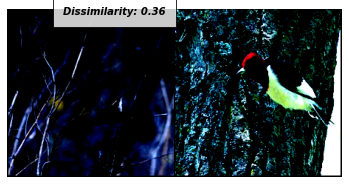

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


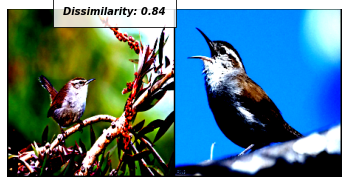

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


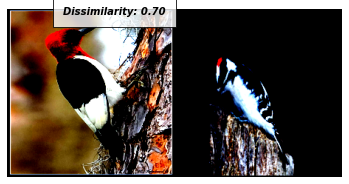

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


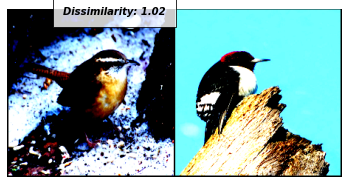

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


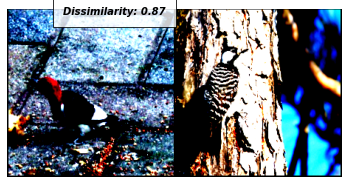

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


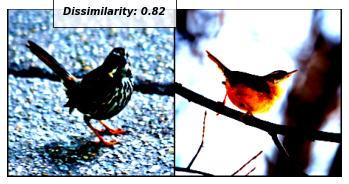

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


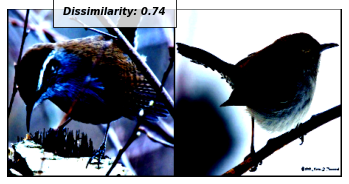

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


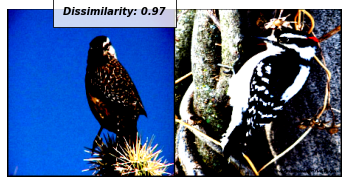

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


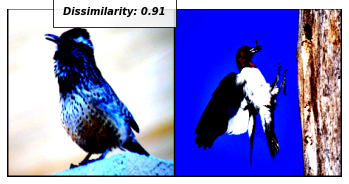

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


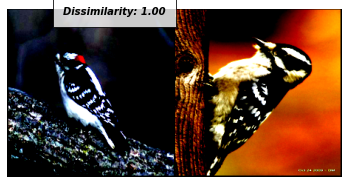

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


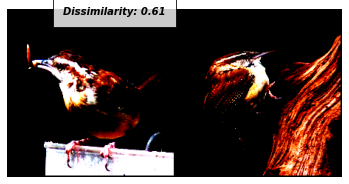

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


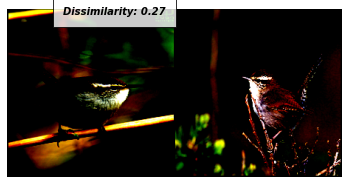

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


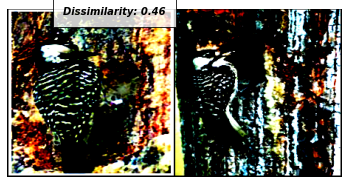

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


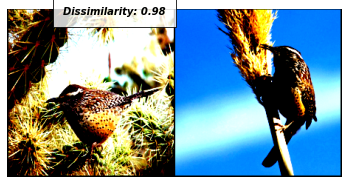

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


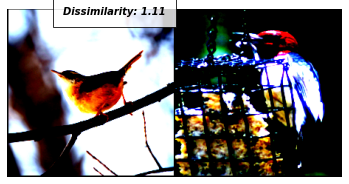

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


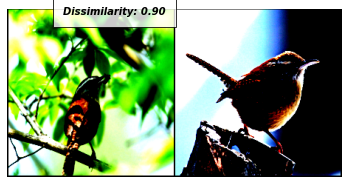

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


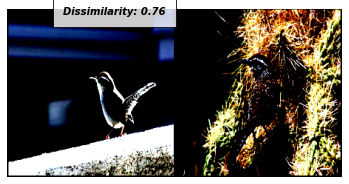

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


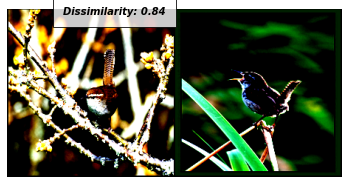

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


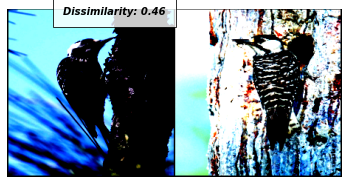

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


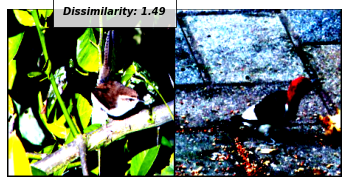

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


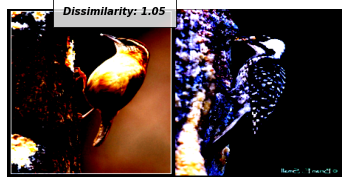

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


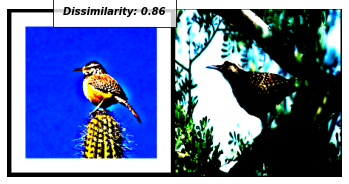

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


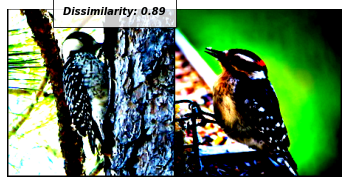

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


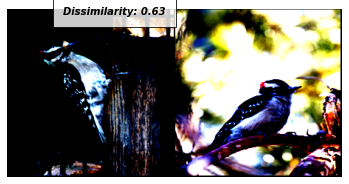

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


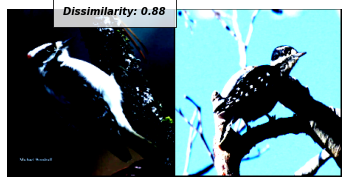

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


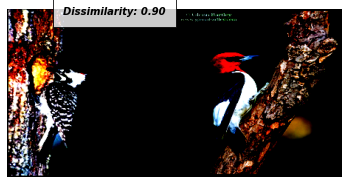

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


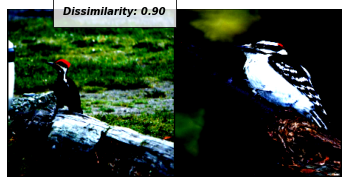

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


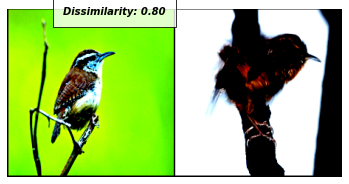

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


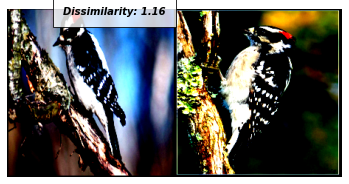

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


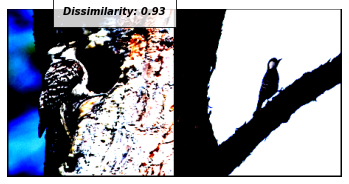

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


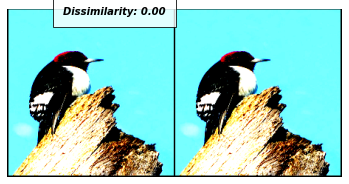

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


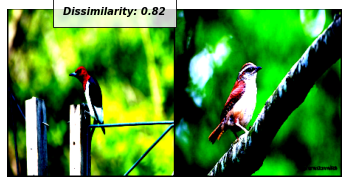

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


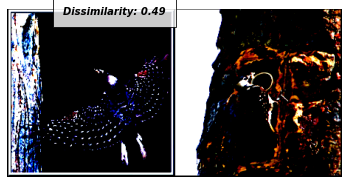

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


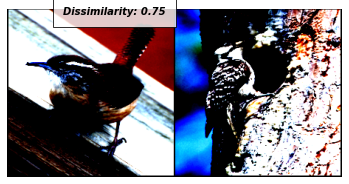

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


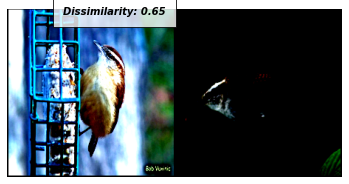

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


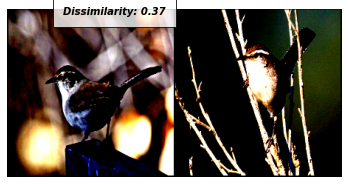

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


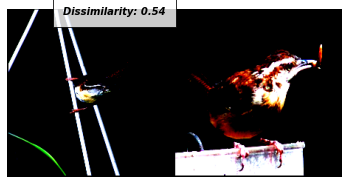

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


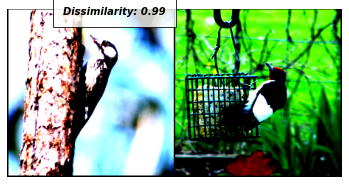

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


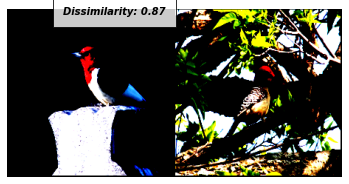

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


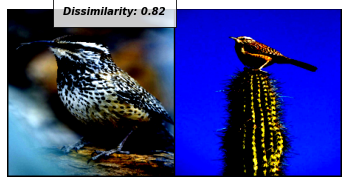

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


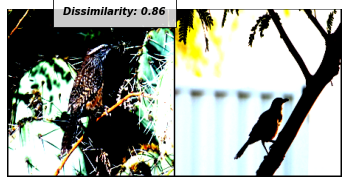

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


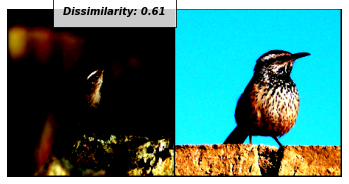

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


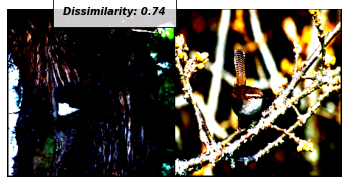

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


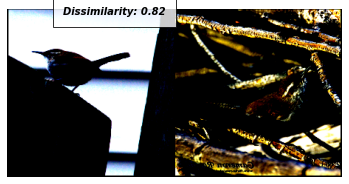

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


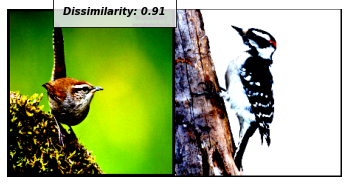

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


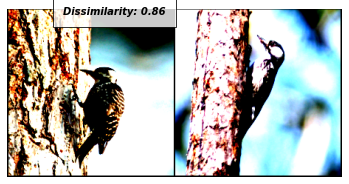

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


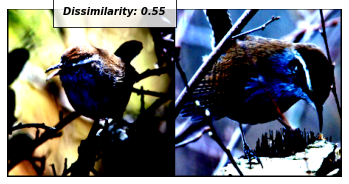

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


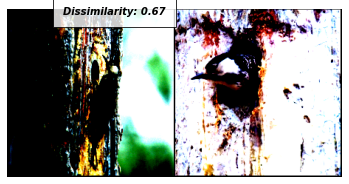

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


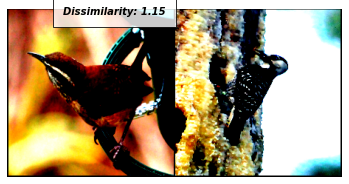

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


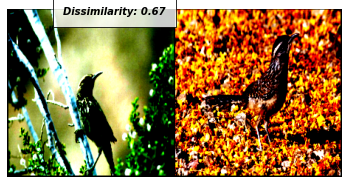

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


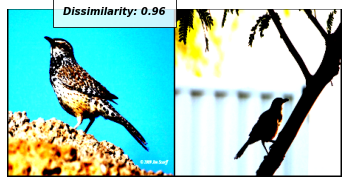

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


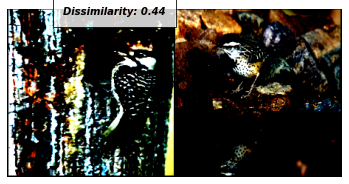

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


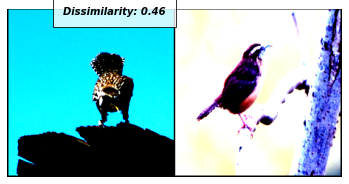

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


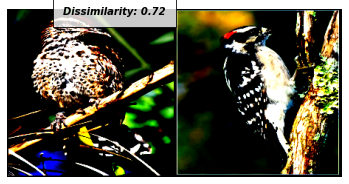

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


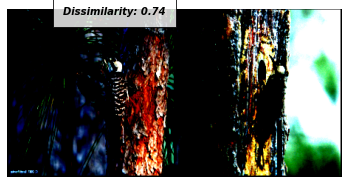

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


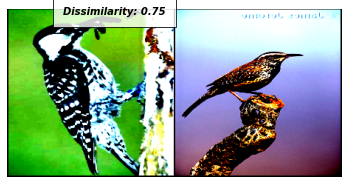

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


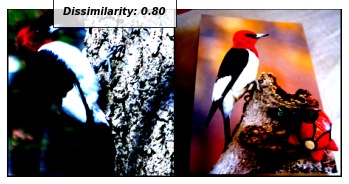

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


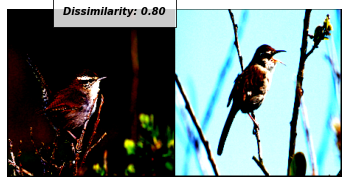

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


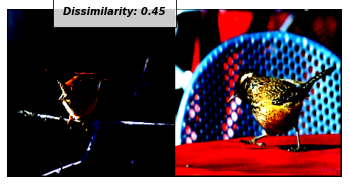

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


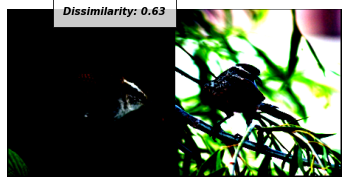

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


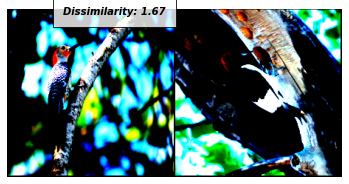

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


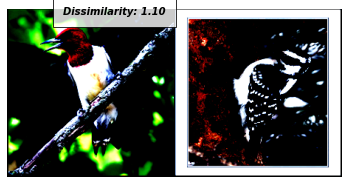

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


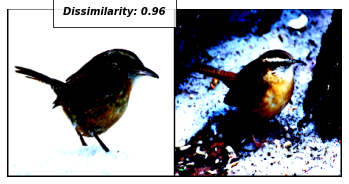

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


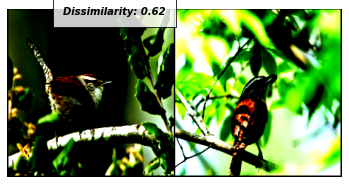

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


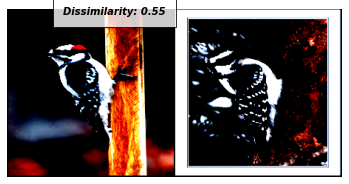

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


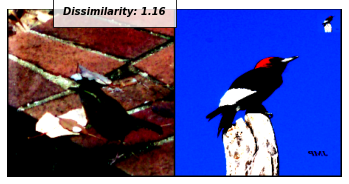

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


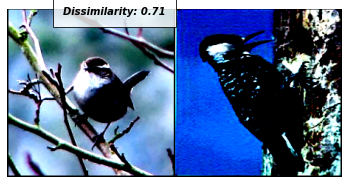

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


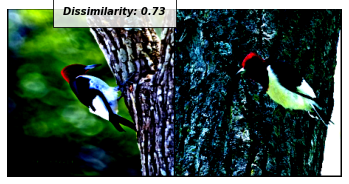

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


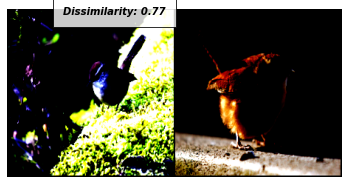

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


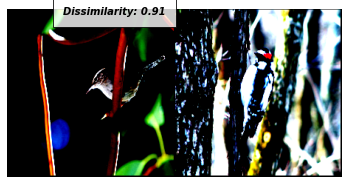

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


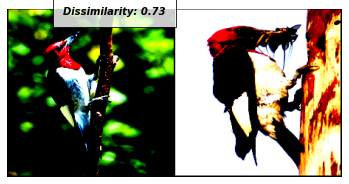

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


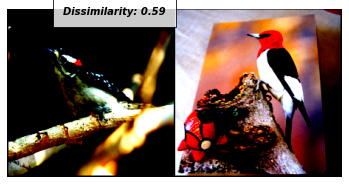

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


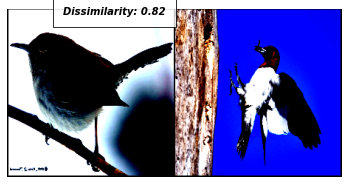

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


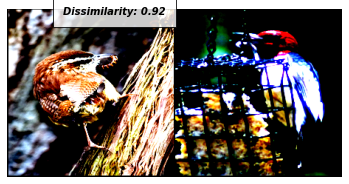

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


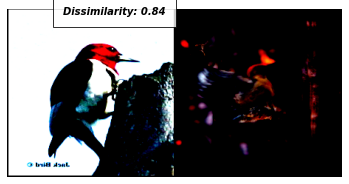

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


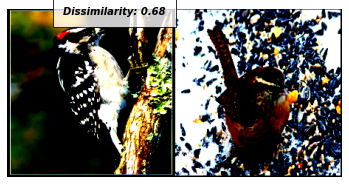

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


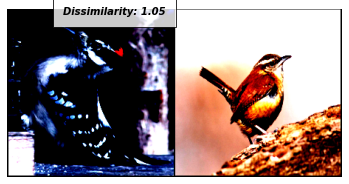

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


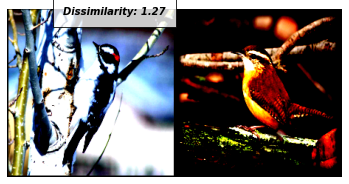

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


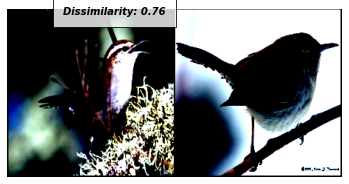

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


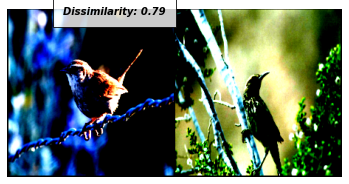

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


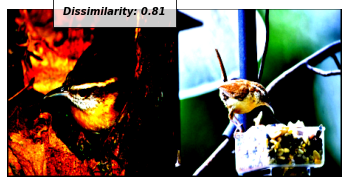

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


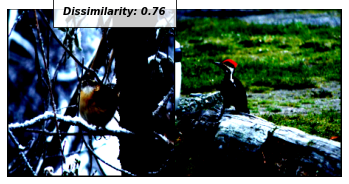

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


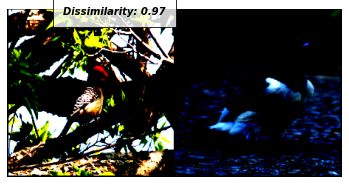

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


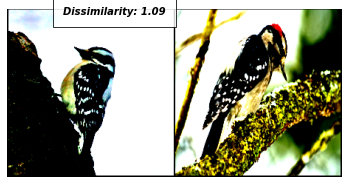

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


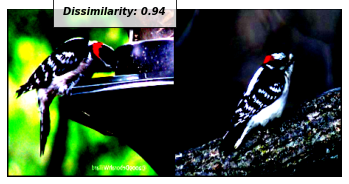

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


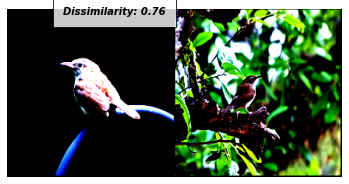

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


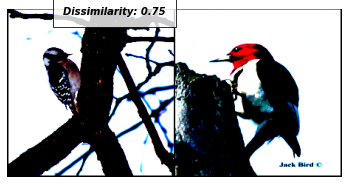

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


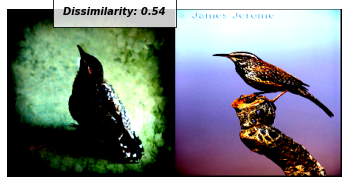

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


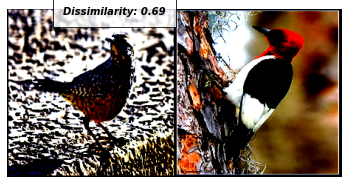

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


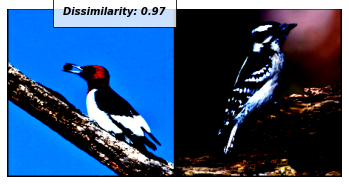

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


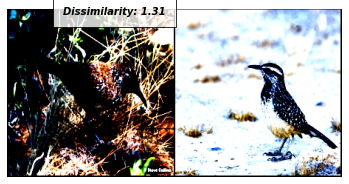

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


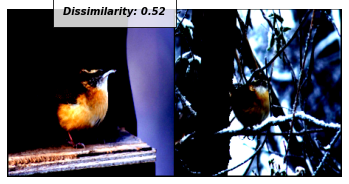

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


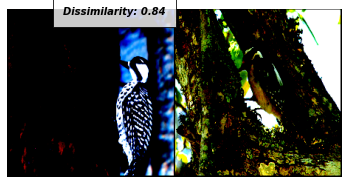

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


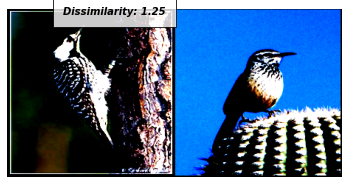

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


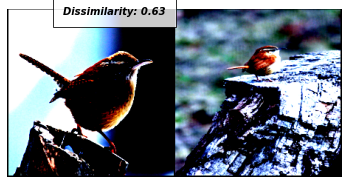

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


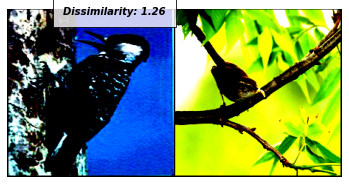

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


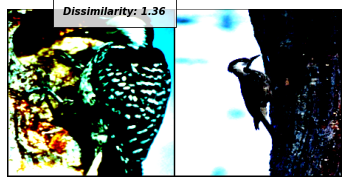

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


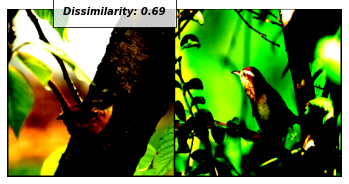

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


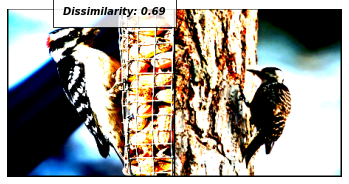

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


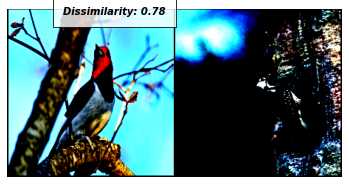

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


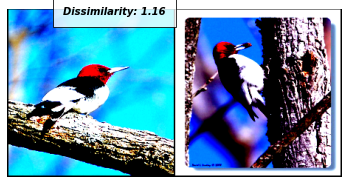

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


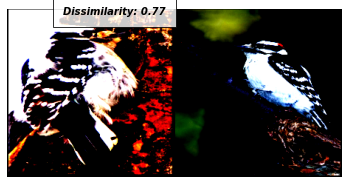

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


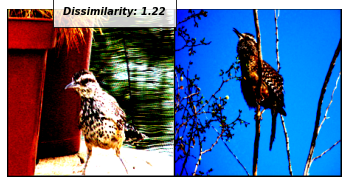

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


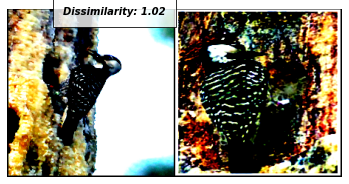

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


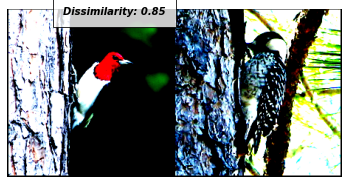

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


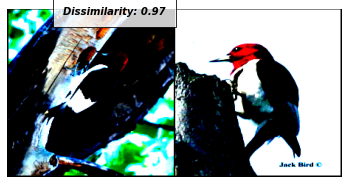

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


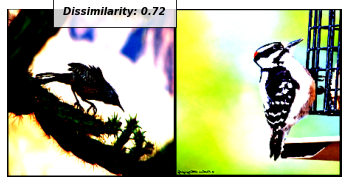

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


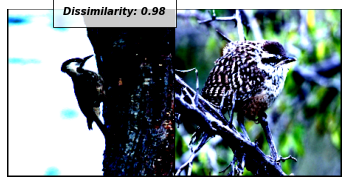

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


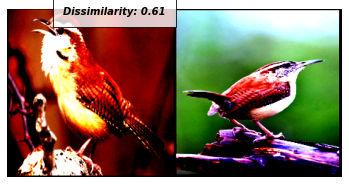

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


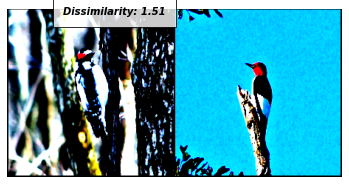

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


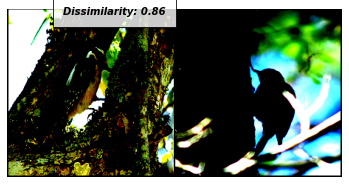

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


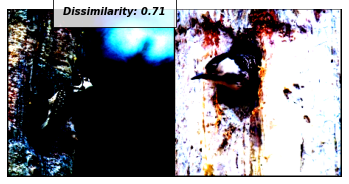

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


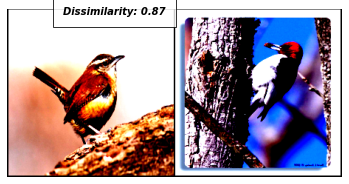

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


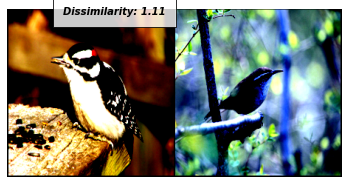

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


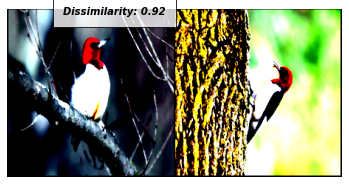

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


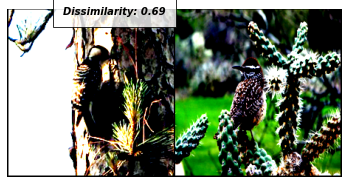

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


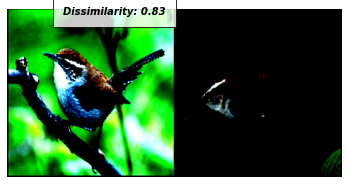

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


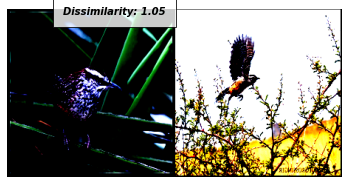

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


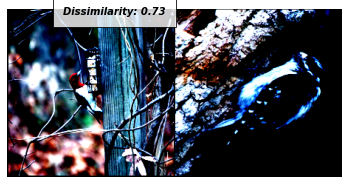

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


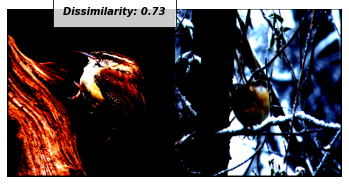

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


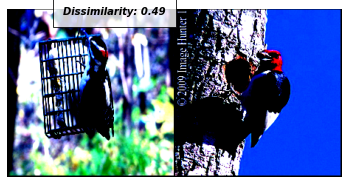

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


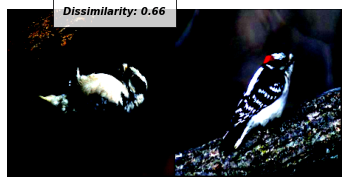

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


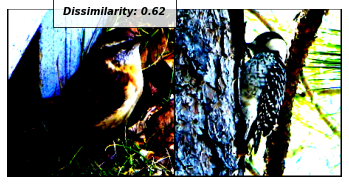

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


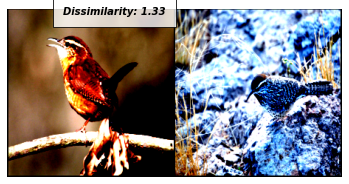

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


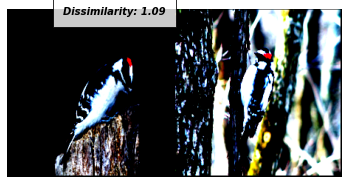

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


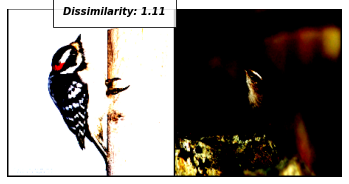

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


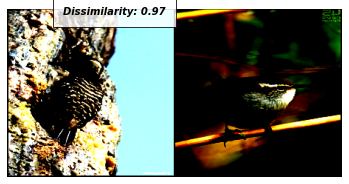

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


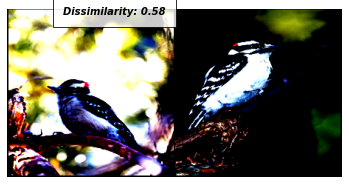

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


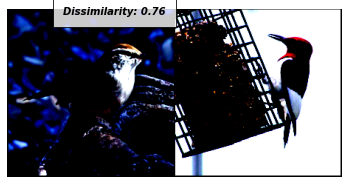

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


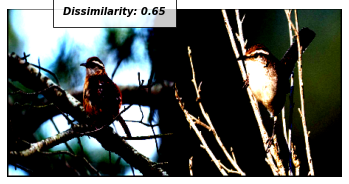

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


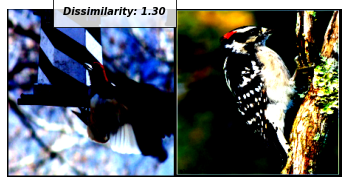

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


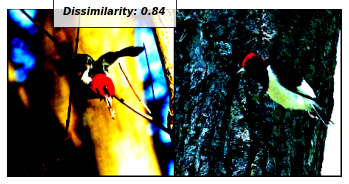

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


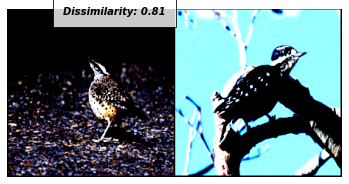

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


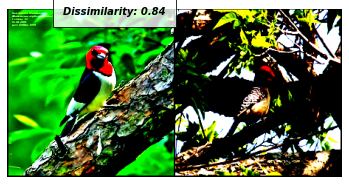

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


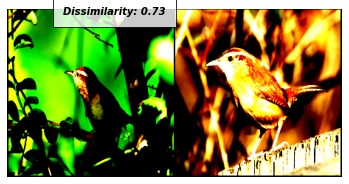

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


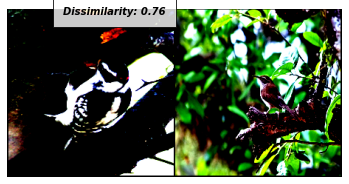

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


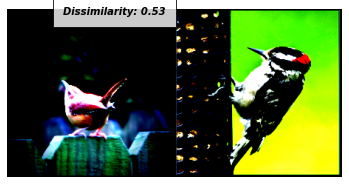

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


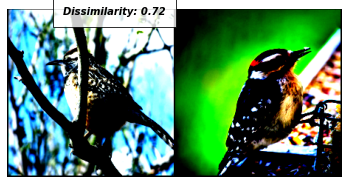

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


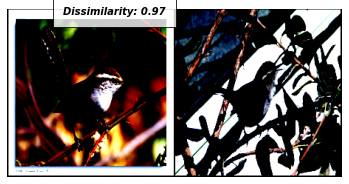

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


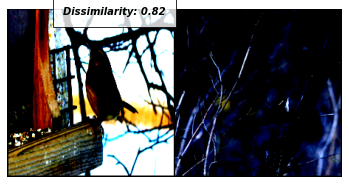

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


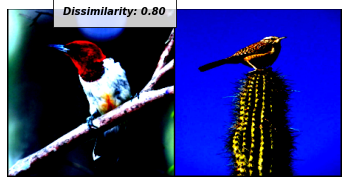

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


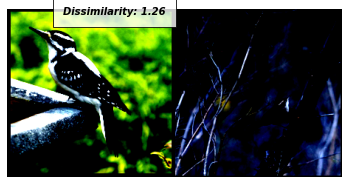

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


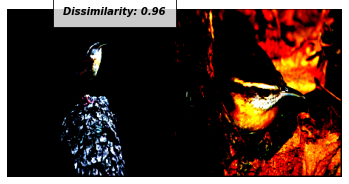

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


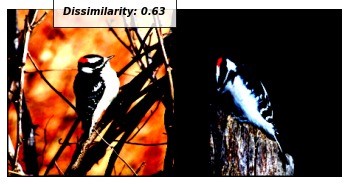

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


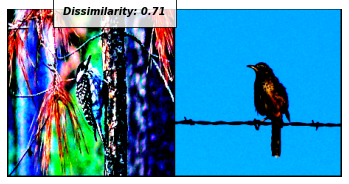

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


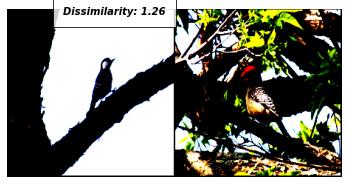

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


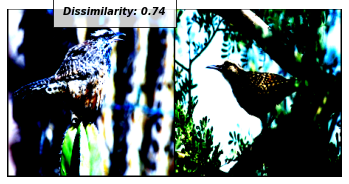

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


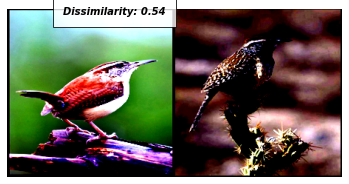

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


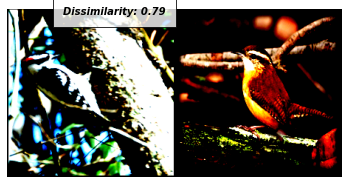

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


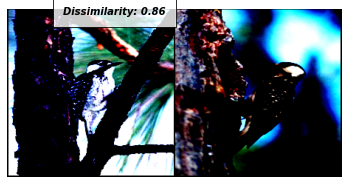

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


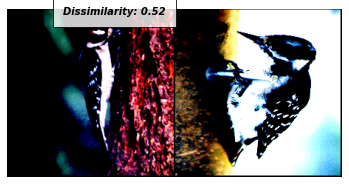

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


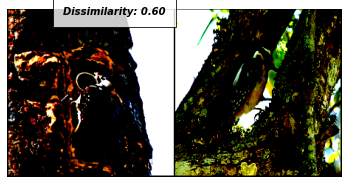

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


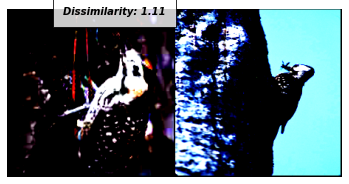

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


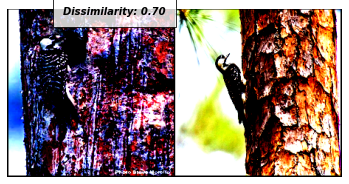

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


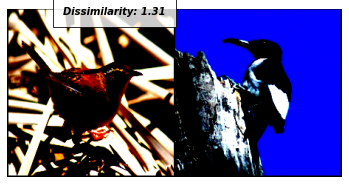

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


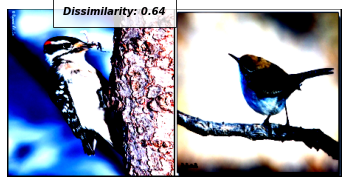

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


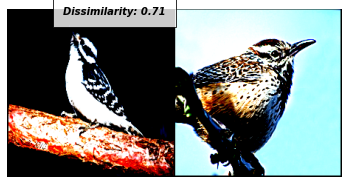

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


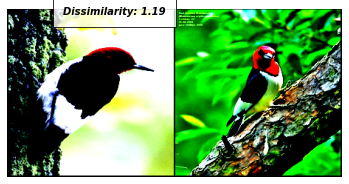

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


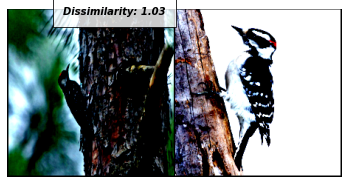

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


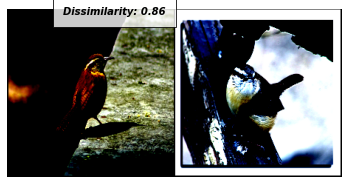

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


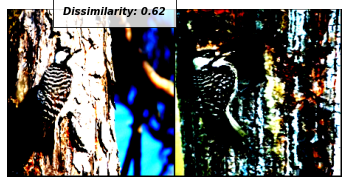

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


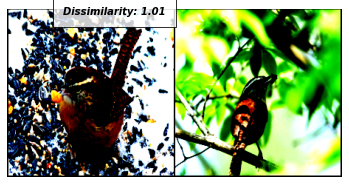

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


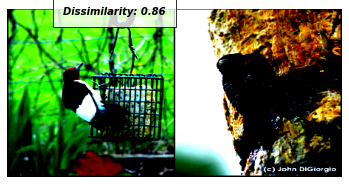

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


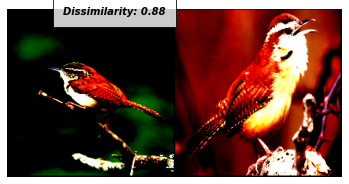

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


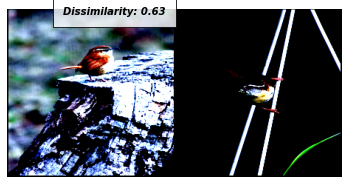

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


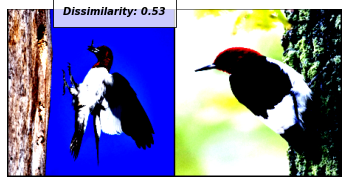

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


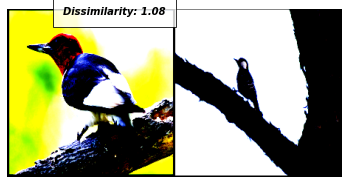

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


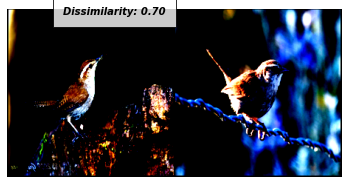

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


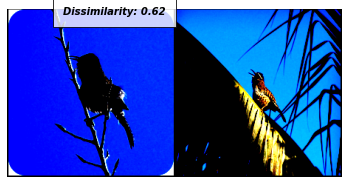

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


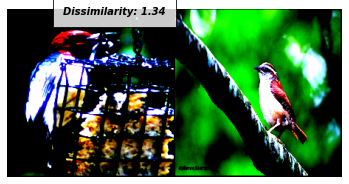

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


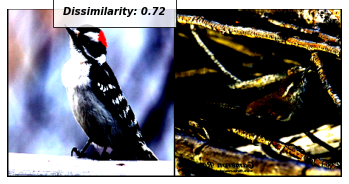

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


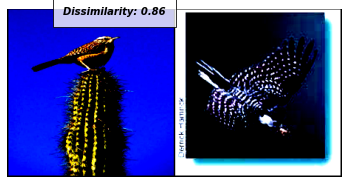

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


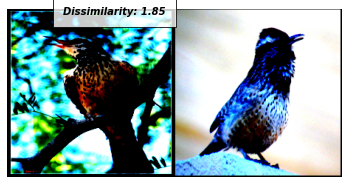

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


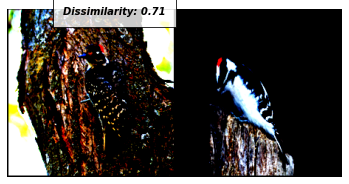

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


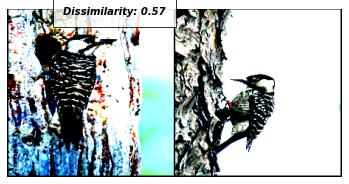

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


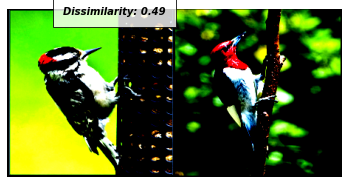

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


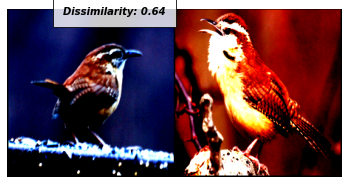

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


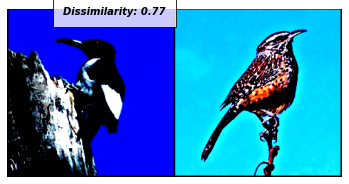

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


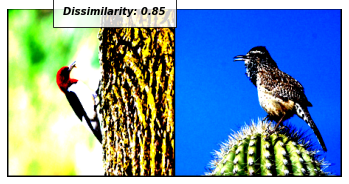

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


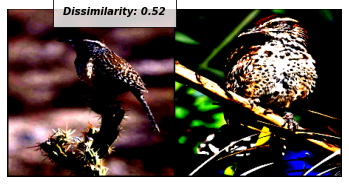

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


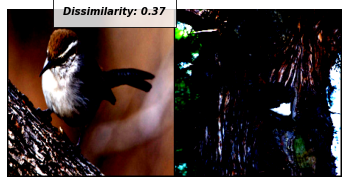

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


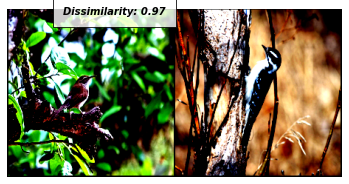

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


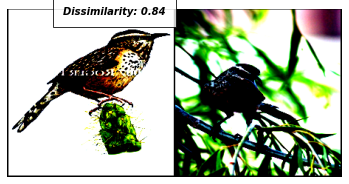

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


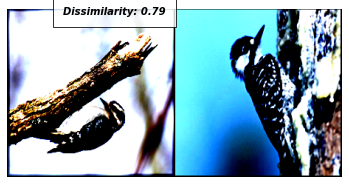

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


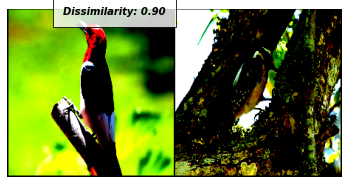

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


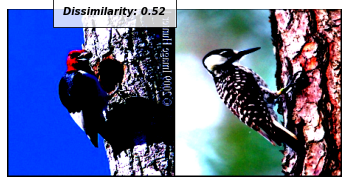

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


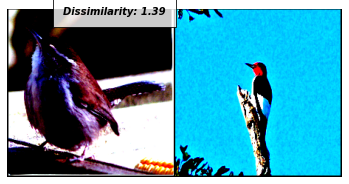

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


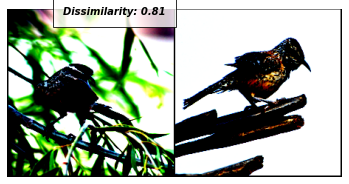

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


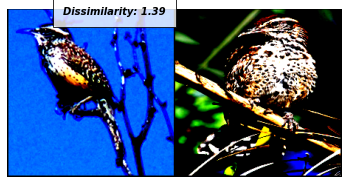

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


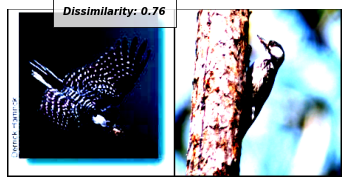

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


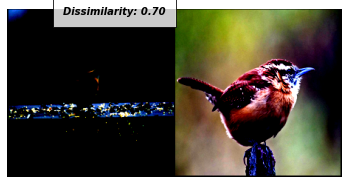

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


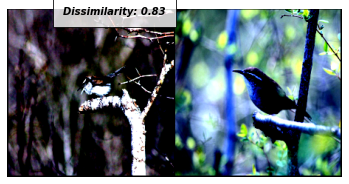

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


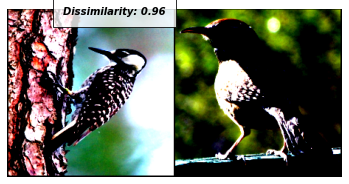

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


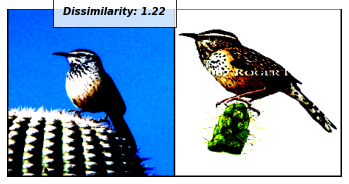

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


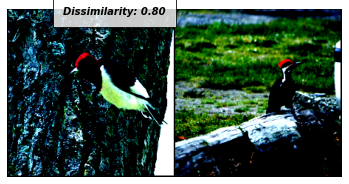

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


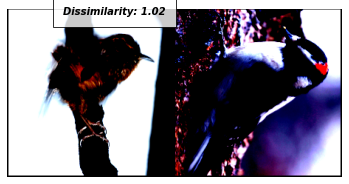

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


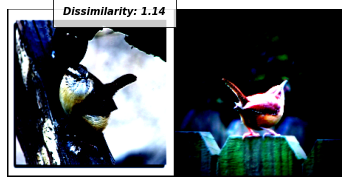

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


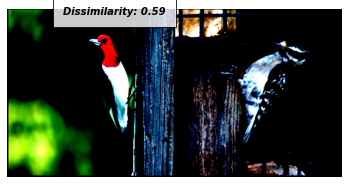

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


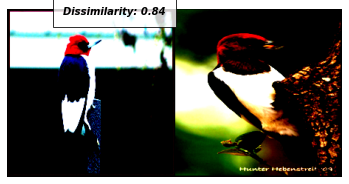

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


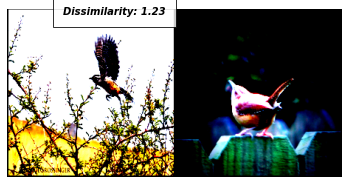

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


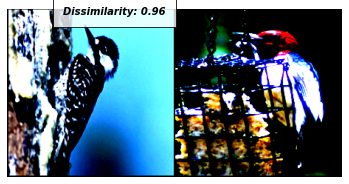

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


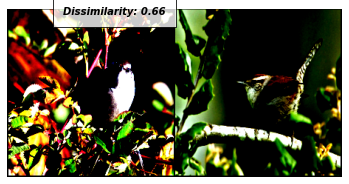

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


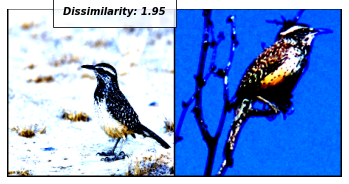

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


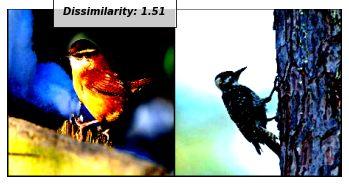

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


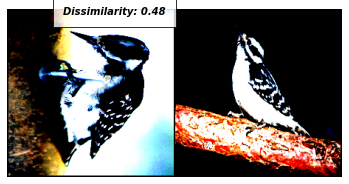

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


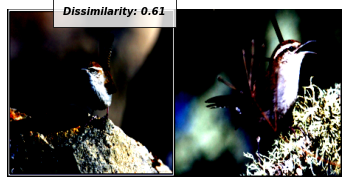

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


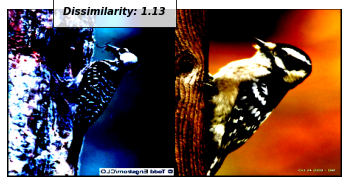

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


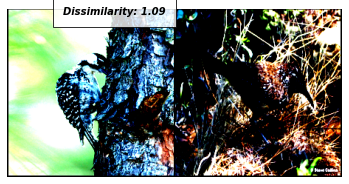

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


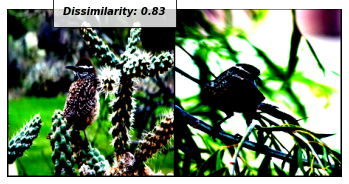

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


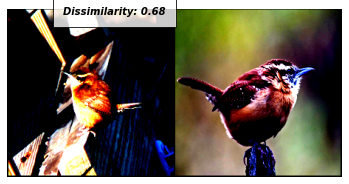

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


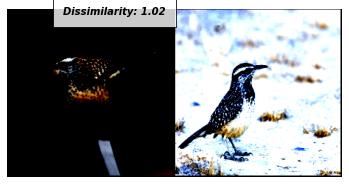

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


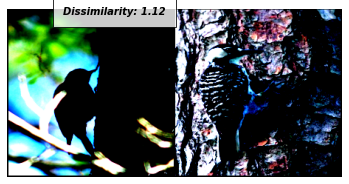

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


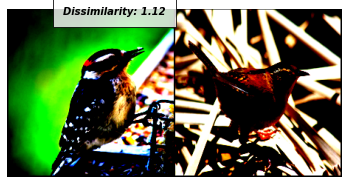

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


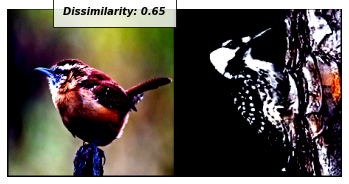

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


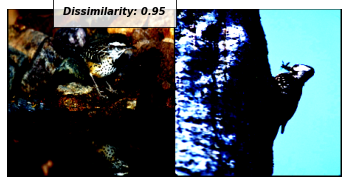

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


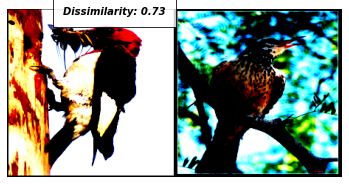

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


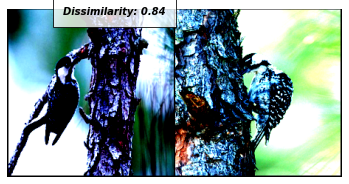

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


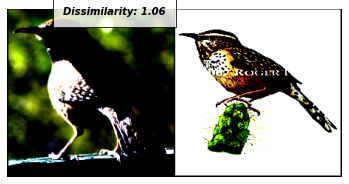

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


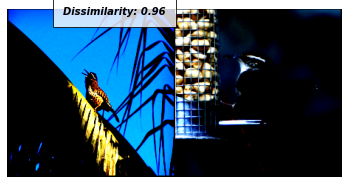

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


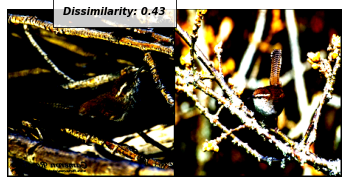

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


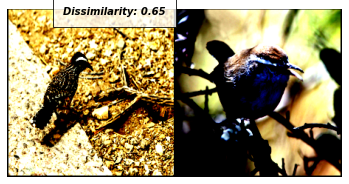

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


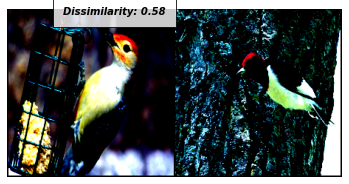

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


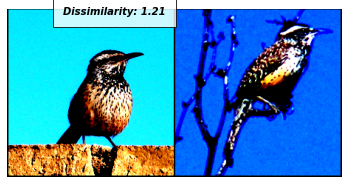

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


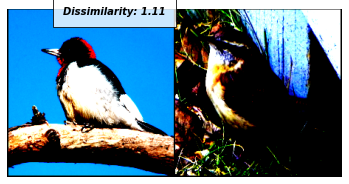

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


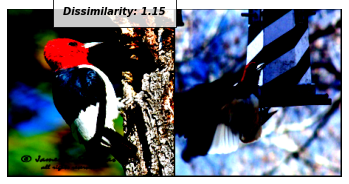

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


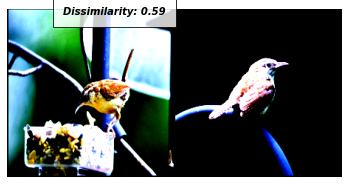

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


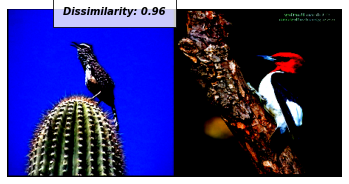

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


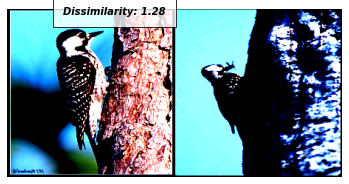

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


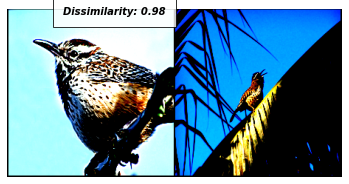

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


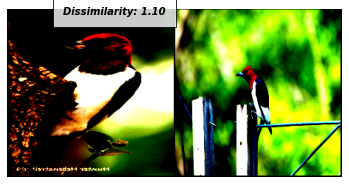

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


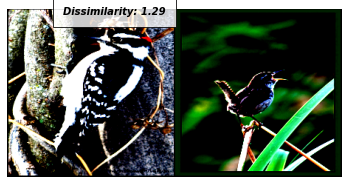

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


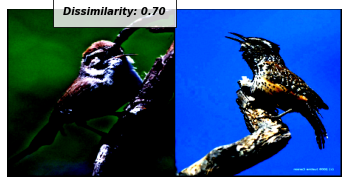

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


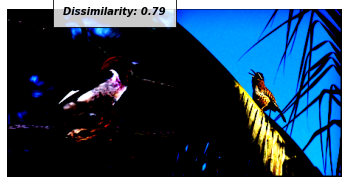

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


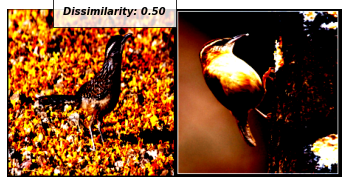

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


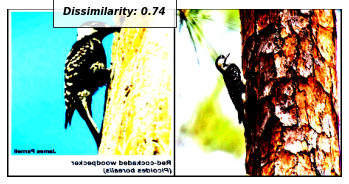

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


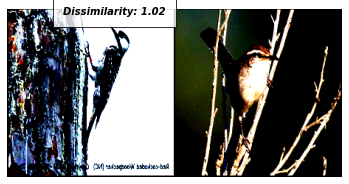

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


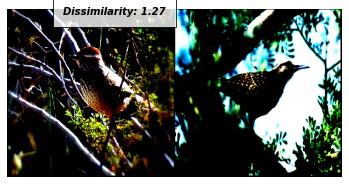

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


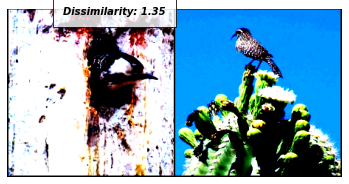

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


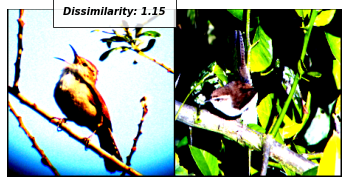

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


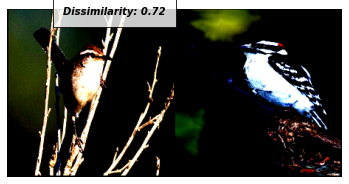

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


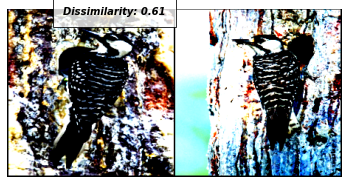

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


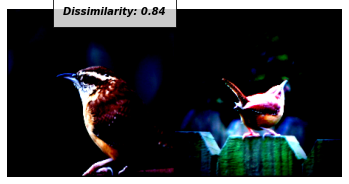

Avg Test Acc: 0.7178770949720671


In [46]:
tester.vis_test()

We can see the network is not able to capture the fine grained details of a species of bird but is getting distracted the position in which the bird is sitting, the background in which the image was captured etc while trying to find the similarity between 2 pictures. For a fine grained low data per class dataset like CUBS we will need a more powerful network